In [20]:
#from imageai.Detection import ObjectDetection
import datetime
import os
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from IPython.display import Image

IMAGES_PATH = "images/"
VIDEOS_PATH = "videos/"
utils = "Utils/"

# ImageAI Lib

In [2]:
execution_path = os.getcwd()

detector = ObjectDetection()
detector.setModelTypeAsYOLOv3()
detector.setModelPath( os.path.join(execution_path , utils + "yolo.h5"))
#detection_speed="fast"
detector.loadModel(detection_speed="fastest")
custom_objects = detector.CustomObjects(bottle=True)

In [ ]:
import cv2 as cv

cap = cv.VideoCapture(1)

# Get the video writer initialized to save the output video
i = 0
while cv.waitKey(1) < 0:

    #while cv.waitKey(1) < 0:

    # get frame from the video
    hasFrame, frame = cap.read()
    frame = cv.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    rows,cols = frame.shape[:2]   
    frame = frame[:, round(cols/2 - rows/2):round(cols/2 + rows/2)]
    
    rows,cols = frame.shape[:2]   
    frame = cv.resize(frame,(round(cols*0.3),round(rows*0.3)))

    angle = 0
    '''if i%2 == 0:
        angle = 90
    M = cv2.getRotationMatrix2D((cols/2,rows/2),angle,1)
    frame = cv2.warpAffine(frame,M,(cols,rows))'''
    
    cv.imwrite(IMAGES_PATH + "cam_stream.jpg",frame)

    start_time = datetime.datetime.now()
    detections = detector.detectCustomObjectsFromImage(input_image=os.path.join(execution_path , IMAGES_PATH + "cam_stream.jpg"), output_image_path=os.path.join(execution_path , IMAGES_PATH + "detection_imageai.png"), custom_objects=custom_objects, minimum_percentage_probability=1)
    print("time: " + str(datetime.datetime.now() - start_time))   

    result = cv.imread(IMAGES_PATH + "detection_imageai.png")
    '''M = cv2.getRotationMatrix2D((cols/2,rows/2),360-angle,1)
    result = cv2.warpAffine(result,M,(cols,rows))'''
    result = cv.resize(result,(round(cols*0.4),round(rows*0.4)))
    cv.imshow("result", result)
    i = i + 1



time: 0:00:00.437602


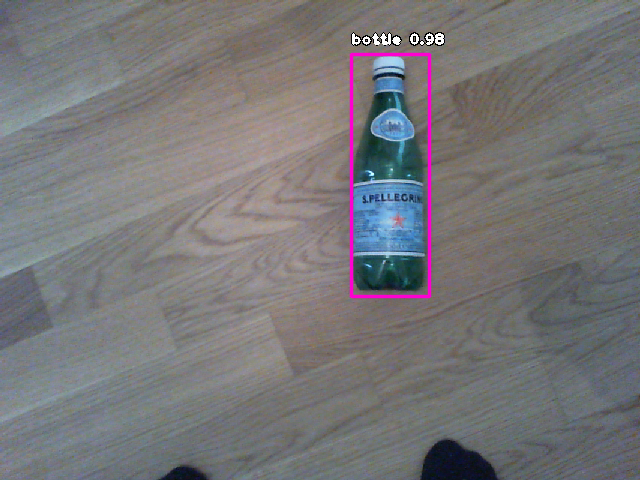

In [41]:
start_time = datetime.datetime.now()
detections = detector.detectCustomObjectsFromImage(input_image=os.path.join(execution_path , IMAGES_PATH + "bottle.bmp"), output_image_path=os.path.join(execution_path , IMAGES_PATH + "detection_imageai.png"), custom_objects=custom_objects, minimum_percentage_probability=1)
print("time: " + str(datetime.datetime.now() - start_time)) 
Image(filename = IMAGES_PATH + "detection_imageai.png")

# Haar Cascade

In [6]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
face_cascade = cv.CascadeClassifier(utils + 'haar_bottle.xml')
img = cv.imread(IMAGES_PATH + 'positive/pos_20190528_135854.bmp')
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

pos_20190528_135827.bmp


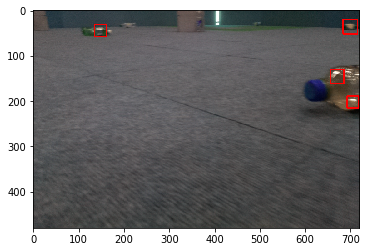

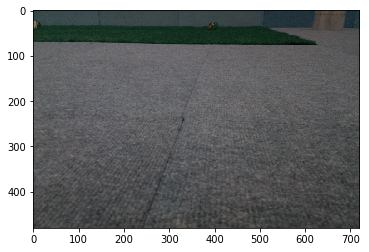

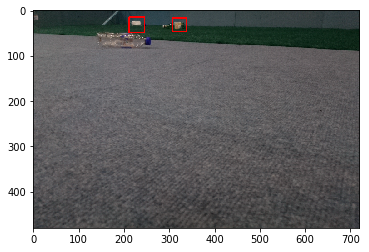

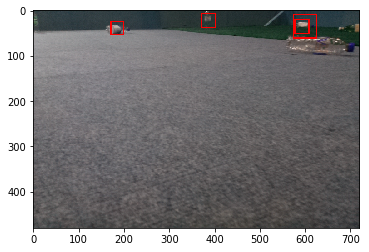

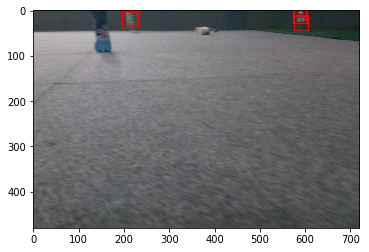

...

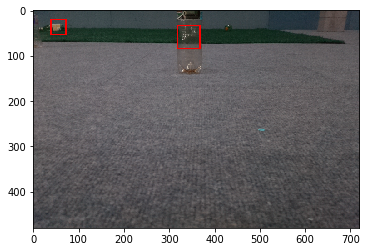

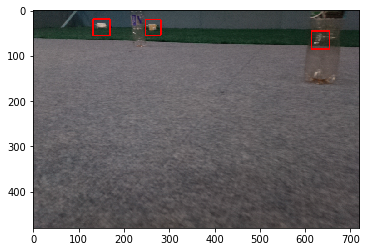

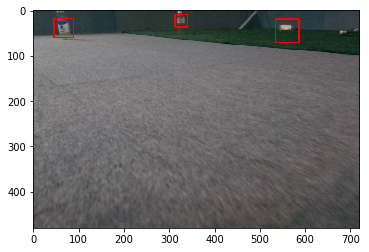

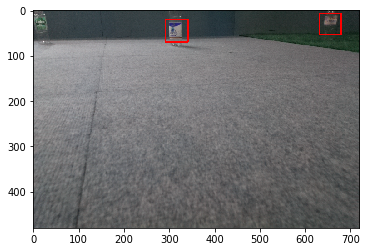

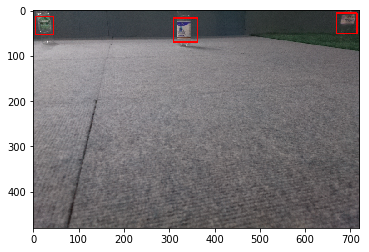

In [19]:
from glob import glob                                                           
import cv2 as cv
bmps = glob('./images/positive/*.bmp', recursive=True)

for name in bmps:
    img = cv.imread(IMAGES_PATH + 'positive/' + name[-23:])
    faces = face_cascade.detectMultiScale(img)
    for (x,y,w,h) in faces:
        cv.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    '''cv.imwrite(IMAGES_PATH + "bottle_haar.png", img)
    Image(filename = IMAGES_PATH + 'bottle_haar.png')'''
    plt.figure()
    plt.imshow(img)
    plt.show()

# Neural Network Pytorch

In [15]:
import torch
import datetime
import math
import matplotlib.pyplot as plt
from torch import optim
from torch import Tensor
from torch.autograd import Variable
from torch import nn
from torch.nn import functional as F
import dlc_practical_prologue 
import warnings
warnings.filterwarnings('ignore')  

#Size of the data to load
size=1000;
train_input, train_target, train_classes, test_input, test_target, test_classes = \
    dlc_practical_prologue.generate_pair_sets(size)
train_input, train_target, train_classes = Variable(train_input), Variable(train_target), Variable((train_classes))
test_input, test_target, test_classes = Variable(test_input), Variable(test_target), Variable(test_classes)

In [16]:
my_train_input = train_input.reshape([2*size,196])
my_train_classes = train_classes.reshape([2*size])

my_test_input = test_input.reshape([2*size,196])
my_test_classes = test_classes.reshape([2*size])

In [17]:
# number of epoch
num_epochs = 25
# batch size to compute mini-batch
batch_size = 100
# number of pixels in the image 
input_size = 196
# number of possible digit: 0 to 9 
num_class = 10
# small step to find a minima
learning_rate = 0.004
# hidden size
hidden_size = 50
# p dropout
p_dropout = 0

# Fully connected neural network
class NeuralNet(nn.Module):
    def __init__(self, input_size, hidden_size, num_class, p_dropout, kernel_size1, kernel_size2, conv_size_out1, conv_size_out2):
        super(NeuralNet, self).__init__()
        self.layer1 = nn.Sequential(
            nn.Conv2d(1, conv_size_out1, kernel_size=kernel_size1, stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=3))
        self.layer2 = nn.Sequential(
            nn.Conv2d(conv_size_out1, conv_size_out2, kernel_size=kernel_size2, stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=3, stride=3))
        self.fc1 = nn.Linear(conv_size_out2, hidden_size)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size, num_class)
        self.dropout = nn.Dropout(p_dropout)
    
    def forward(self, x, batch_size_images):
        x = x.reshape(batch_size_images,1,14,14)
        out = self.layer1(x)        
        out = self.layer2(out)
        out = out.reshape(out.size(0), -1)
        out = self.fc1(out)
        out = self.dropout(out)
        out = self.relu(out)
        out = self.fc2(out)
        return out

In [18]:
# function to train each model
def train_model(model_, my_train_input_, my_train_classes_, criterion_, optimizer_,num_epochs_,batch_size_,learning_rate_decay):
    # getting start time of train to get the train time at the end thanks to "end_time"
    start_time = datetime.datetime.now()
    # Learning rate decay can be enabled or disabled than to an input in the function's parameters
    if learning_rate_decay:
        lambda_ = lambda epoch: 0.8 ** epoch
        scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer_, lr_lambda=lambda_)
    for epoch in range(1, num_epochs_+1):
        # using technique of mini batch (size of the batch in the function's parameters)
        for i in range(int(len(my_train_input_)/batch_size_)):  
            # getting images and labels in right format
            images = my_train_input_.narrow(0,i*batch_size_,batch_size_)
            labels = my_train_classes_.narrow(0,i*batch_size_,batch_size_)

            # Forward pass
            outputs = model_(images, batch_size_)
            loss = criterion_(outputs, labels)

            # Backward and optimize
            optimizer_.zero_grad()
            loss.backward()
            optimizer_.step()            
        
        if learning_rate_decay:
            scheduler.step()
    # getting train error at each epoch
    train_error = test_accuracy(model_, my_train_input_, my_train_classes_)
    test_error = test_accuracy(model_, my_test_input, my_test_classes)
    # getting end time and training time
    end_time = datetime.datetime.now()
    training_time = end_time - start_time
    print ('Loss: {:.4f} on epoch: {}, train error: {:.5f}, avg test error on 10 different samples: {:.5f}'.format(loss.item(),epoch,train_error,test_error))
    return train_error, test_error, training_time

In [19]:
def test_accuracy(model_, my_test_input_, my_test_classes_):
    total = my_test_input_.size(0)

    outputs = model_(my_test_input_, total)
    _, predictions = torch.max(outputs.data, 1)

    well_predicted_count = (predictions.long() == my_test_classes_.long()).sum().item()

    return 1 - well_predicted_count / total

In [20]:
batch_size, hidden_size, learning_rate, LRD, p_dropout = 20, 25, 0.004, True, 0
kernel_size1, kernel_size2, conv_size_out1, conv_size_out2 = 5, 5, 16, 32
model = NeuralNet(input_size, hidden_size, num_class, p_dropout, kernel_size1, kernel_size2, conv_size_out1, conv_size_out2)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate)  
train_error_HS, test_error_HS, train_time_HS = train_model(model, my_train_input, my_train_classes, criterion, optimizer,num_epochs,batch_size,LRD)

Loss: 0.1621 on epoch: 25, train error: 0.03400, avg test error on 10 different samples: 0.09250


In [21]:
checkpoint = {'model': NeuralNet(input_size, hidden_size, num_class, p_dropout, kernel_size1, kernel_size2, conv_size_out1, conv_size_out2),
          'state_dict': model.state_dict(),
          'optimizer' : optimizer.state_dict()}

torch.save(checkpoint, 'checkpoint.pth')

In [22]:
def load_checkpoint(filepath):
    checkpoint = torch.load(filepath)
    model = checkpoint['model']
    model.load_state_dict(checkpoint['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False

    model.eval()
    return model

loaded_model = load_checkpoint('checkpoint.pth')

time: 0:00:00.002001
prediction: 7


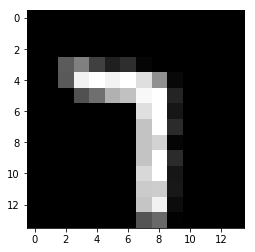

In [23]:
img = my_test_input[1:2,:].reshape([14,14])
start_time = datetime.datetime.now()
outputs = model(my_test_input[1:2,:], 1)
print("time: " + str(datetime.datetime.now() - start_time))   
_, predictions = torch.max(outputs.data, 1)
print("prediction: " + str(predictions.item()))
plt.imshow(img, cmap='gray', interpolation='none')